<a href="https://colab.research.google.com/github/Himasishghosal/Control-Theory_And_ANN/blob/main/3_ANIMATED_CONTROLLER.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**`"Animated Controller Design and Simulation for a Satellite System Using Numerical and Analytical Methods"`**

>#                                           `Presented By Himasish Ghosal`

>#                                            `Guided By Prof. Raju.k.George`

#**`Objective:`**
**To compute and visualize the optimal control inputs for a linear satellite system using:**

>**Analytical control computation via the controllability Grammian**

>**Numerical integration of the system dynamics using RK4**

>**Comparison and animation of state trajectories**




#**`System Description:`**
**I am working with a satellite system modeled as a linear time-invariant (LTI) system:**

**dx(t)/dt=Ax(t)+Bu(t)**

**Where:**
**x(t)∈R4: state vector ; u(t)∈R2: control input ; A and B: system matrices based on orbital mechanics**

#**Task-1**
>**Compute the control of the given system using discrete integration method (simpson) and visualization**







In [ ]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from scipy.linalg import expm

# Parameters
sigma = 1
omega = 1

# System matrices
A = np.array([[0, 1, 0, 0],
              [3*omega**2, 0, 0, 2*omega],
              [0, 0, 0, 1],
              [0, -2*omega, 0, 0]])

B = np.array([[0, 0],
              [1, 0],
              [0, 0],
              [0, 1]])


n = A.shape[0]        # state dimension
m = B.shape[1]
T = 20                 # final time
N = 100               # number of time points
time_points = np.linspace(0, T, N)

**Computation of the Controllability Grammian**

In [ ]:
from scipy.integrate import quad_vec

def compute_grammian(A, B, T):
    def integrand(t):
        e_At = expm(A * (T - t))
        return e_At @ B @ B.T @ e_At.T  # returns 2D (n x n) NumPy array

    W, _ = quad_vec(integrand, 0, T)
    return W

# To Generate u(t) numerically
def compute_control(A, B, x0, x1, T, time_points):
    W = compute_grammian(A, B, T)
    W_inv = np.linalg.inv(W)
    expAT = expm(A * T)
    diff = x1 - expAT @ x0

    u_vals = []
    for t in time_points:
        e_AtT = expm(A.T * (T - t))
        u_t = B.T @ e_AtT @ W_inv @ diff
        u_vals.append(u_t)
    return np.array(u_vals).T  # shape: (m, N)

# Generate dataset
np.random.seed(42)       # seed for reproducibility
x0 = np.array([0.01,0.01,0.01,0])
x1 = np.array([0,0,0,0])
u_vals = compute_control(A, B, x0, x1, T, time_points).reshape(2,-1)
print(u_vals)

[[-6.38466005e-04 -7.66235478e-04 -8.71885131e-04 -9.51117817e-04
  -1.00071086e-03 -1.01864714e-03 -1.00419713e-03 -9.57948547e-04
  -8.81782495e-04 -7.78796916e-04 -6.53180600e-04 -5.10042807e-04
  -3.55205459e-04 -1.94966340e-04 -3.58429443e-05  1.15692615e-04
   2.53476850e-04  3.71905586e-04  4.66161907e-04  5.32412073e-04
   5.67961455e-04  5.71364134e-04  5.42481711e-04  4.82488936e-04
   3.93825929e-04  2.80098928e-04  1.45933614e-04 -3.21303399e-06
  -1.61274692e-04 -3.21822432e-04 -4.78326207e-04 -6.24420454e-04
  -7.54163002e-04 -8.62276760e-04 -9.44364359e-04 -9.97087005e-04
  -1.01830028e-03 -1.00714137e-03 -9.64064134e-04 -8.90820690e-04
  -7.90390103e-04 -6.66857243e-04 -5.25246628e-04 -3.71318064e-04
  -2.11332374e-04 -5.17967416e-05  1.00799952e-04  2.40251058e-04
   3.60884606e-04  4.57794000e-04  5.27037593e-04  5.65799001e-04
   5.72501660e-04  5.46872950e-04  4.89955281e-04  4.04063696e-04
   2.92691712e-04  1.60369221e-04  1.24782494e-05 -1.44965953e-04
  -3.05559

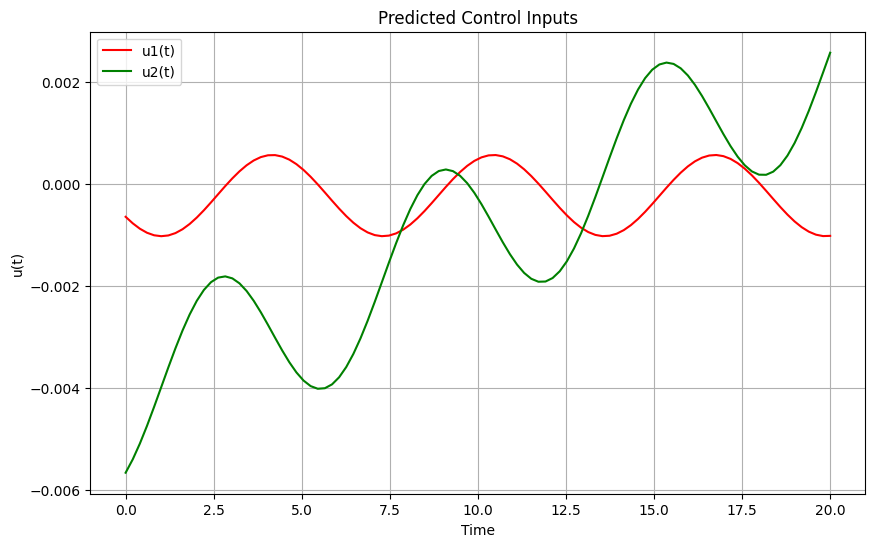

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.plot(time_points, u_vals[0], label='u1(t)', color='r')
plt.plot(time_points, u_vals[1], label='u2(t)', color='g')
plt.title("Predicted Control Inputs")
plt.xlabel("Time")
plt.ylabel("u(t)")
plt.legend()
plt.grid(True)
plt.show()

**Implementation of Simpson's Integration**

The solution of the system using discrete integration of the formula is:
State at t=20.00: [ 8.12404770e-07  2.86880432e-07  1.23703671e-07 -1.74199481e-06]


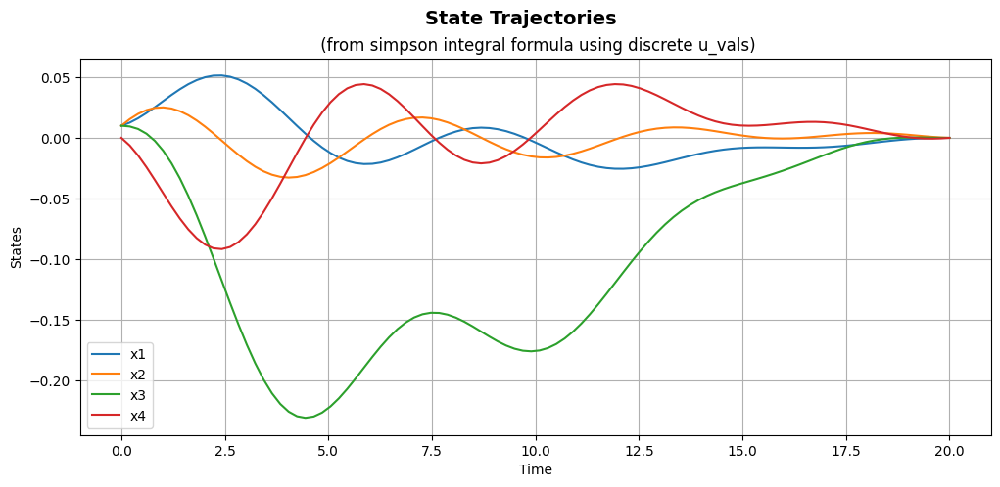

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import expm # For matrix exponential
from scipy.integrate import simpson # For numerical integration using Simpson's rule

n = A.shape[0] # State dimension
m = B.shape[1]

# Initialize the state trajectory array
x_trajectory_discrete_int = np.zeros((len(time_points), n))

# The initial state is x(0) = x0
x_trajectory_discrete_int[0, :] = x0

# Iterate through the time points to compute x(t) at each point
for i, t in enumerate(time_points):
    if i == 0:
        continue # Already set the initial state

    # Select the time points up to the current time t (inclusive) and the corresponding u_pred values
    time_points_subset = time_points[:i+1]
    u_vals_subset = u_vals[:, :i+1] # u_pred shape is (m, N)

    # Calculate the first part: exp(A*t) * x0
    exp_At = expm(A * t)
    x_part1 = exp_At @ x0

    # Calculate the integrand values at the discrete time points in the subset [0, t]
    # The integrand is F(s) = exp(A*(t-s)) @ B @ u(s)
    # F(s) is a vector of shape (n,)
    integrand_values = np.zeros((n, len(time_points_subset)))

    for k, s in enumerate(time_points_subset):
        exp_A_ts = expm(A * (t - s))
        u_s = u_vals_subset[:, k].reshape(-1, 1) # u at time s, reshaped to column vector
        integrand_values[:, k] = (exp_A_ts @ B @ u_s).flatten()

    # Numerically integrate the integrand values from 0 to t using Simpson's rule
    # Integrate each component of the vector integrand separately
    integral_result = np.zeros(n)
    for j in range(n): # Integrate for each state variable component
        # integrand_values[j, :] contains the values of the j-th component of the integrand at time_points_subset
        integral_result[j] = simpson(integrand_values[j, :], time_points_subset)

    # The state x(t) is the sum of the two parts
    x_trajectory_discrete_int[i, :] = x_part1 + integral_result

print("The solution of the system using discrete integration of the formula is:")
# Print the trajectory at the final time point as an example
print(f"State at t={time_points[-1]:.2f}: {x_trajectory_discrete_int[-1]}")

z = time_points

# x_trajectory_discrete_int has shape (N, n), so I slice columns for each state
xt1 = x_trajectory_discrete_int[:, 0]
xt2 = x_trajectory_discrete_int[:, 1]
xt3 = x_trajectory_discrete_int[:, 2]
xt4 = x_trajectory_discrete_int[:, 3]


plt.figure(figsize=(12, 5))
plt.plot(z, xt1, label='x1')
plt.plot(z, xt2, label='x2')
plt.plot(z, xt3, label='x3')
plt.plot(z, xt4, label='x4')
plt.suptitle("State Trajectories",fontsize=14,fontweight='bold')
plt.title(" (from simpson integral formula using discrete u_vals)")
plt.xlabel("Time")
plt.ylabel("States")
plt.legend()
plt.grid(True)
plt.show()

**Visualization and Animation(In 2D path)**

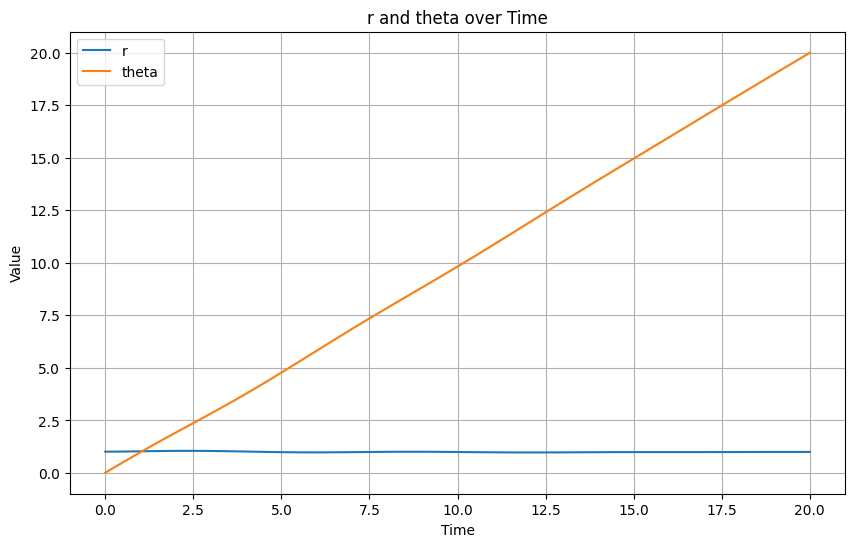

In [ ]:
# Calculate theta from x3 = sigma * (theta - omega * t)
# theta = x3/sigma + omega * t
theta_vals = x_trajectory_discrete_int[:, 2] / sigma + omega * time_points

# Calculate r from x1 = r - sigma
# r = x1 + sigma
r_vals = x_trajectory_discrete_int[:, 0] + sigma

# Plot r and theta against time
plt.figure(figsize=(10, 6))
plt.plot(time_points, r_vals, label='r')
plt.plot(time_points, theta_vals, label='theta')
plt.title("r and theta over Time")
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend()
plt.grid(True)
plt.show()

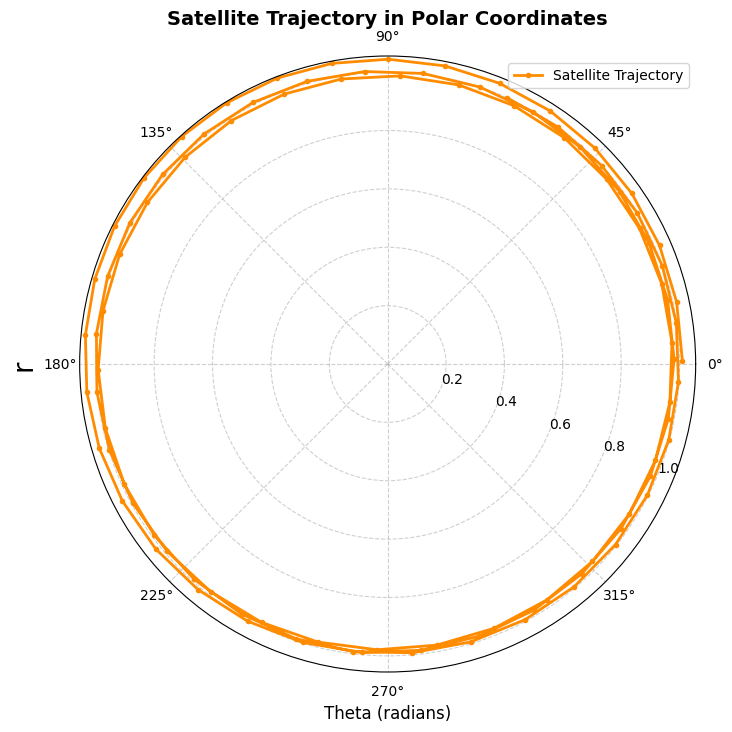

In [ ]:
# Create a polar plot
plt.figure(figsize=(8, 8))
ax = plt.subplot(111, projection='polar')

# Plotting of the trajectory in polar coordinates with visual enhancements
ax.plot(theta_vals, r_vals, color='darkorange', linestyle='-', linewidth=2, marker='o', markersize=3, label='Satellite Trajectory')

ax.set_title("Satellite Trajectory in Polar Coordinates", va='bottom', fontsize=14, fontweight='bold', pad=20)
ax.set_xlabel("Theta (radians)", fontsize=12)
ax.set_ylabel("r", fontsize=20, labelpad=30)

ax.set_rlabel_position(-22.5)  # Move radial labels away from plotted line
ax.grid(True, linestyle='--', alpha=0.6)
ax.legend(loc='upper right')

plt.show()

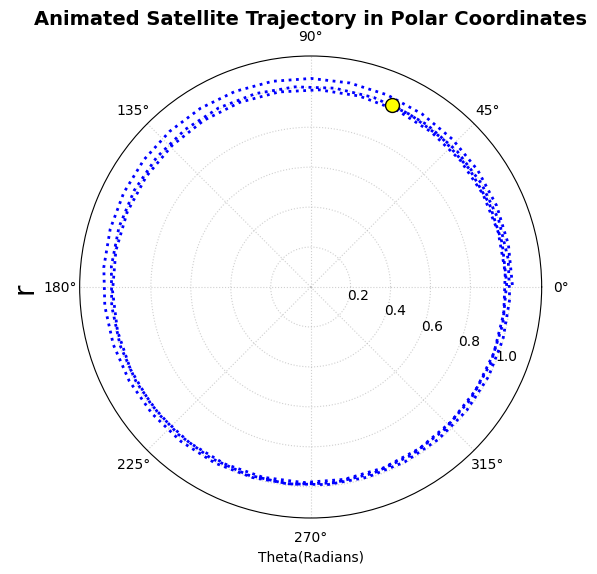

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Set up the figure and axis for polar plot
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw={'projection': 'polar'})
ax.set_title("Animated Satellite Trajectory in Polar Coordinates", va='bottom', fontsize=14, fontweight='bold', pad=20)
ax.set_rlabel_position(-22.5)
ax.grid(True, linestyle=':', alpha=0.6)
ax.set_xlabel("Theta(Radians)")
ax.set_ylabel("r",labelpad=30,fontsize=20)
ax.set_ylim(0, np.max(r_vals) * 1.1)

# Initialize the plot line
line, = ax.plot([], [], color='blue', linestyle=':', linewidth=2, label='Trajectory')

# Initialize the satellite marker
satellite_marker, = ax.plot([], [], 'o', color='yellow', markersize=10, markeredgecolor='black', label='Satellite')

def init():
    line.set_data([], [])
    satellite_marker.set_data([], [])
    return line, satellite_marker

def update(frame):
    # Plot full trajectory up to current point
    line.set_data(theta_vals[:frame+1], r_vals[:frame+1])
    # Update satellite position
    satellite_marker.set_data([theta_vals[frame]], [r_vals[frame]])
    return line, satellite_marker

# Animate
ani = FuncAnimation(fig, update, frames=len(time_points), init_func=init, blit=True)

# Display in Google Colab
from IPython.display import HTML
HTML(ani.to_jshtml())

#**Task-2**
>**Implemented the RK4 method using interpolation for the control input to solve the ODE dx/dt = Ax + Bu, where A and B are given matrices and u is a time-varying control input. Compare the results with the discrete integration method and visualize the state trajectories. Use the provided `u_vals` and `time_points` for the control input interpolation.**

##**To Define the ode function**

### Subtask:
To Create a Python function that represents the state-space equation `dx/dt = Ax + Bu`.


**Reasoning**:
The subtask requires defining a function that implements the state-space equation. I am creating the `ode_system` function.



In [ ]:
def ode_system(t, x, u_interp):
    """
    Represents the state-space equation dx/dt = Ax + Bu.

    Args:
        t (float): Current time.
        x (np.ndarray): Current state vector (n,).
        u_interp (callable): Interpolation function for the control input u(t).
                             Takes time 't' as input and returns the control vector (m,).

    Returns:
        np.ndarray: The derivative of the state vector dx/dt (n,).
    """
    # Get the control input at the current time t using the interpolation function
    u_t = u_interp(t)

    # Compute the derivative of the state vector: dx/dt = Ax + Bu
    dx_dt = A @ x + B @ u_t

    return dx_dt

## **To Interpolate control input**

### Subtask:
To Create an interpolation function for `u(t)` using the pre-calculated `u_vals` and `time_points`.


In [ ]:
from scipy.interpolate import interp1d

# Create separate interpolators for each control input component
u1_interp = interp1d(time_points, u_vals[0, :], kind='cubic')
u2_interp = interp1d(time_points, u_vals[1, :], kind='cubic')

def u_interp(t):

    #Interpolate each component of the control input u(t) at time t and combine into a vector
    return np.array([u1_interp(t), u2_interp(t)])

## **To Solve the ode with rk45**


In [ ]:
from scipy.integrate import solve_ivp

# Time span for the integration
t_span = (time_points[0], time_points[-1])

# Solve the ODE using solve_ivp with 'RK45' method and interpolated control
# Pass u_interp as args to the ode_system function
sol = solve_ivp(ode_system, t_span, x0, method='RK45', t_eval=time_points, args=(u_interp,))

# Extract the state trajectory (transpose to get shape (N, n))
x_trajectory_rk45 = sol.y.T

print("The solution of the system using solve_ivp with RK45 is:")
print(f"State at t={time_points[-1]:.2f}: {x_trajectory_rk45[-1]}")

The solution of the system using solve_ivp with RK45 is:
State at t=20.00: [ 9.55366094e-05 -4.56732114e-05 -9.09274835e-05 -1.91068565e-04]


##**To Compare and visualize the results**


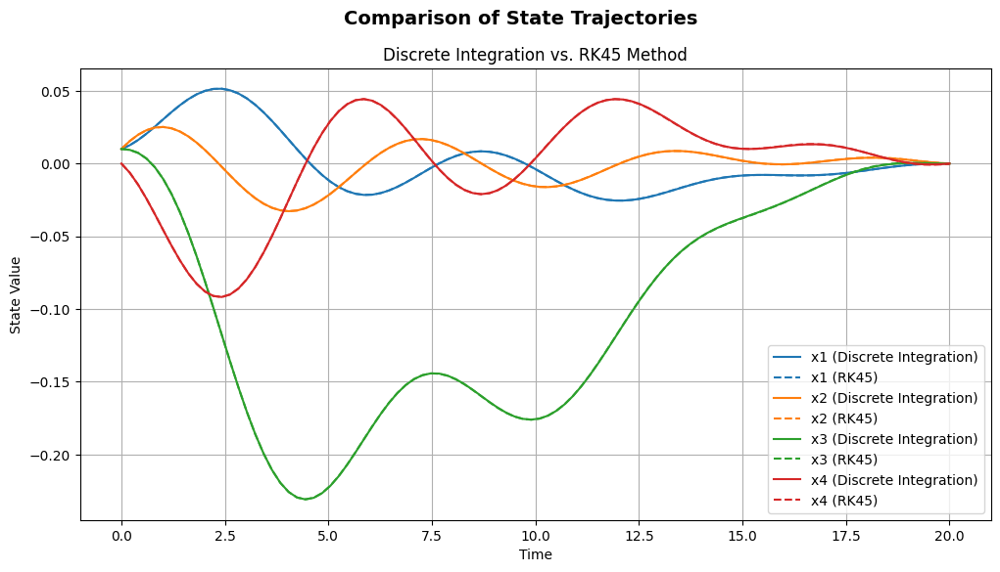

In [ ]:
plt.figure(figsize=(12, 6))

# Plot each state variable from both methods
for i in range(n):
    plt.plot(time_points, x_trajectory_discrete_int[:, i], label=f'x{i+1} (Discrete Integration)', linestyle='-', color=f'C{i}')
    plt.plot(time_points, x_trajectory_rk45[:, i], label=f'x{i+1} (RK45)', linestyle='--', color=f'C{i}')

plt.suptitle("Comparison of State Trajectories", fontsize=14, fontweight='bold')
plt.title("Discrete Integration vs. RK45 Method")
plt.xlabel("Time")
plt.ylabel("State Value")
plt.legend()
plt.grid(True)
plt.show()

# Task-3
>**Non-linear system state using the linear control**



In [ ]:
def state_derivatives(t, x, u1_func, u2_func, sigma, omega, beta):
    x1, x2, x3, x4 = x
    u1 = u1_func(t)
    u2 = u2_func(t)

    dx1 = x2
    dx2 = (x1 + sigma) * ((x4 / sigma) + omega)**2 - beta / (x1 + sigma)**2 + u1
    dx3 = x4
    dx4 = -2 * sigma * ((x4 / sigma) + omega) * (x2 / (x1 + sigma)) + (u2 * sigma) / (x1 + sigma)

    return [dx1, dx2, dx3, dx4]

In [ ]:
from scipy.integrate import solve_ivp
from scipy.interpolate import interp1d
# Constants
beta =sigma**3*omega**2

"""Initial conditions as defined earlier
x0 = np.array([0.05,0,0.05,0])
x1=np.array([0,0,0,0]) """
time_points = np.linspace(0, T, N)
# Time span for backward integration
sol = solve_ivp(
    lambda t, x: state_derivatives(t, x, u1_interp, u2_interp, sigma, omega, beta),
    [time_points[0], time_points[-1]], # Integrate from T to 0
    x0, # Initial condition is x0 (state at time 0)
    t_eval=time_points
)

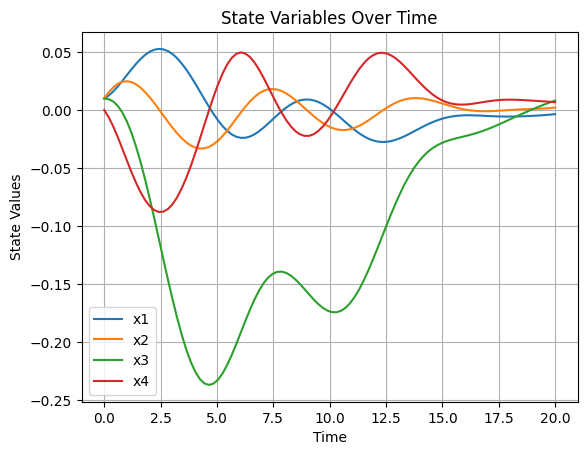

In [ ]:
import matplotlib.pyplot as plt
for i in range(4):
    plt.plot(sol.t, sol.y[i], label=f'x{i+1}')
plt.legend()
plt.title("State Variables Over Time")
plt.xlabel("Time")
plt.ylabel("State Values")
plt.grid(True)
plt.show()


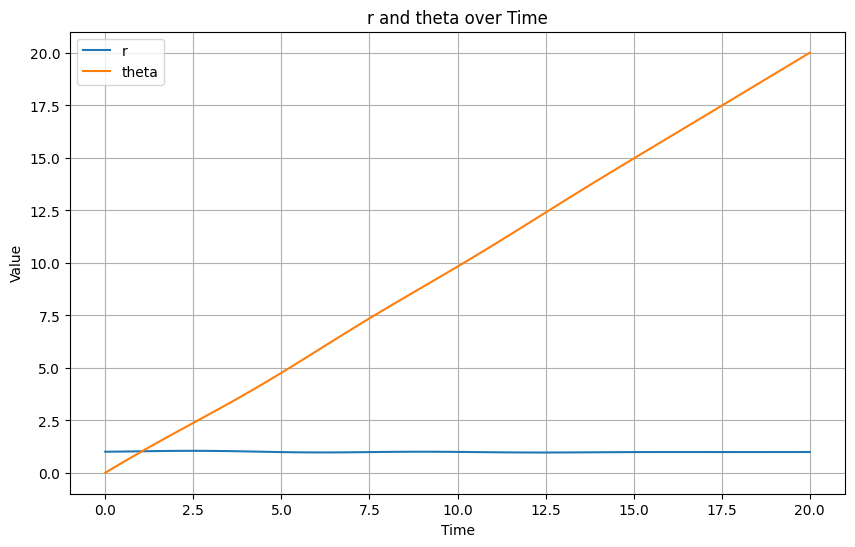

In [ ]:
# Calculate theta from x3 = sigma * (theta - omega * t)
# theta = x3/sigma + omega * t
theta_vals = sol.y[3] / sigma + omega * time_points

# Calculate r from x1 = r - sigma
# r = x1 + sigma
r_vals = x_trajectory_discrete_int[:, 0] + sigma

# Plot r and theta against time
plt.figure(figsize=(10, 6))
plt.plot(time_points, r_vals, label='r')
plt.plot(time_points, theta_vals, label='theta')
plt.title("r and theta over Time")
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend()
plt.grid(True)
plt.show()

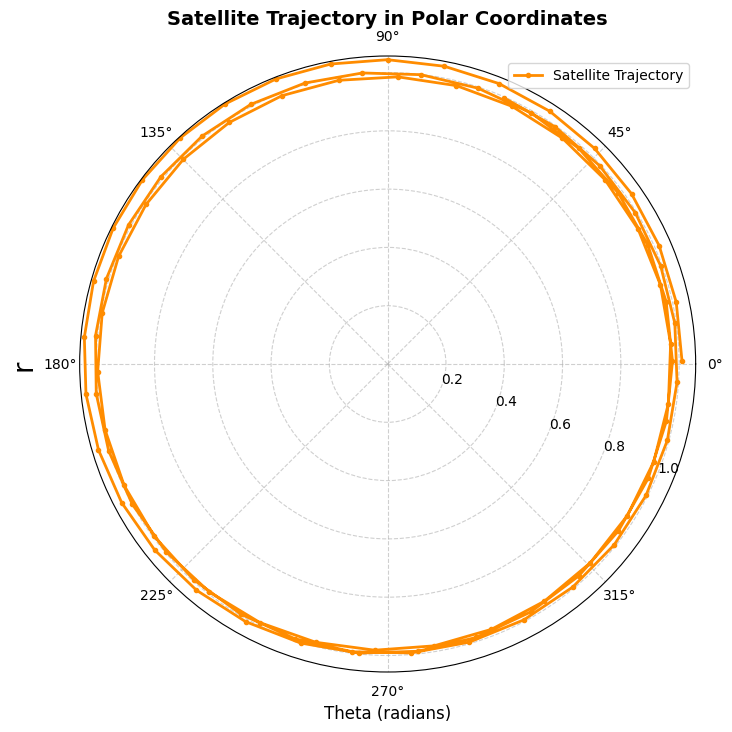

In [ ]:
# Create a polar plot
plt.figure(figsize=(8, 8))
ax = plt.subplot(111, projection='polar')

# Plotting of the trajectory in polar coordinates with visual enhancements
ax.plot(theta_vals, r_vals, color='darkorange', linestyle='-', linewidth=2, marker='o', markersize=3, label='Satellite Trajectory')

ax.set_title("Satellite Trajectory in Polar Coordinates", va='bottom', fontsize=14, fontweight='bold', pad=20)
ax.set_xlabel("Theta (radians)", fontsize=12)
ax.set_ylabel("r", fontsize=20, labelpad=30)

ax.set_rlabel_position(-22.5)  # Move radial labels away from plotted line
ax.grid(True, linestyle='--', alpha=0.6)
ax.legend(loc='upper right')

plt.show()

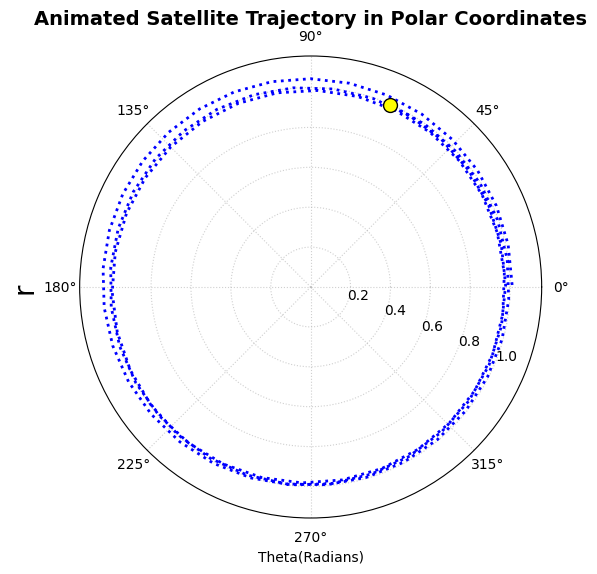

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Set up the figure and axis for polar plot
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw={'projection': 'polar'})
ax.set_title("Animated Satellite Trajectory in Polar Coordinates", va='bottom', fontsize=14, fontweight='bold', pad=20)
ax.set_rlabel_position(-22.5)
ax.grid(True, linestyle=':', alpha=0.6)
ax.set_xlabel("Theta(Radians)")
ax.set_ylabel("r",labelpad=30,fontsize=20)
ax.set_ylim(0, np.max(r_vals) * 1.1)

# Initialize the plot line
line, = ax.plot([], [], color='blue', linestyle=':', linewidth=2, label='Trajectory')

# Initialize the satellite marker
satellite_marker, = ax.plot([], [], 'o', color='yellow', markersize=10, markeredgecolor='black', label='Satellite')

def init():
    line.set_data([], [])
    satellite_marker.set_data([], [])
    return line, satellite_marker

def update(frame):
    # Plot full trajectory up to current point
    line.set_data(theta_vals[:frame+1], r_vals[:frame+1])
    # Update satellite position
    satellite_marker.set_data([theta_vals[frame]], [r_vals[frame]])
    return line, satellite_marker

# Animate
ani = FuncAnimation(fig, update, frames=len(time_points), init_func=init, blit=True)

# Display in Google Colab
from IPython.display import HTML
HTML(ani.to_jshtml())

# Task-5
>  State of the Non-Linear system taking some random control(sin,cos,....)

In [ ]:
def state_derivatives(t, x, u1_func, u2_func, sigma, omega, beta):
    x1, x2, x3, x4 = x
    u1 = u1_func(t)
    u2 = u2_func(t)

    dx1 = x2
    dx2 = (x1 + sigma) * ((x4 / sigma) + omega)**2 - beta / (x1 + sigma)**2 + u1
    dx3 = x4
    dx4 = -2 * sigma * ((x4 / sigma) + omega) * (x2 / (x1 + sigma)) + (u2 * sigma) / (x1 + sigma)

    return [dx1, dx2, dx3, dx4]


In [ ]:
from scipy.integrate import solve_ivp
from scipy.interpolate import interp1d
import numpy as np

# Example discrete time points and control inputs
t_points = np.linspace(0, 10, 100)

# Define u1_vals and u2_vals as constant functions
def u1_vals(t):
    return 0.0 # Constant value for u1

def u2_vals(t):
    return 0.0 # Constant value for u2


# # Create separate interpolators for each control input component
# u1_interp = interp1d(time_points, u_vals[0, :], kind='cubic')
# u2_interp = interp1d(time_points, u_vals[1, :], kind='cubic')

# Constants
sigma = 1.0
omega = 1.0
beta = sigma**3*omega**2

# Initial conditions
x0 = [0.0, 0.0, 0.0, 0.0]

# Time span
sol = solve_ivp(
    lambda t, x: state_derivatives(t, x, u1_vals, u2_vals, sigma, omega, beta),
    [t_points[0], t_points[-1]],
    x0,
    t_eval=t_points
)

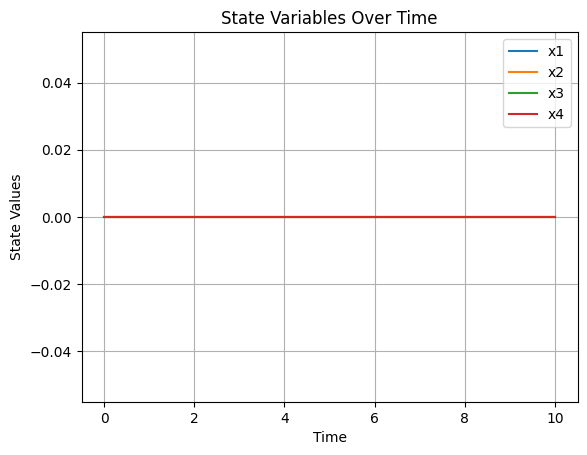

In [ ]:
import matplotlib.pyplot as plt
for i in range(4):
    plt.plot(sol.t, sol.y[i], label=f'x{i+1}')
plt.legend()
plt.title("State Variables Over Time")
plt.xlabel("Time")
plt.ylabel("State Values")
plt.grid(True)
plt.show()


#**Mathematical and Computational Tools Used:**



* **Matrix exponentials (expm)**
* **Controllability Grammian for analytical control**
* **Numerical integration: RK4 method,Simpson's Method**
* **SciPy: solve_ivp, quad_vec**
* **Matplotlib: Static and animated plots**
* **Numpy: Core numerical computations**





#**Key Outcomes:**

* **I derived the analytical control law using the Grammian and validated it by simulating the system using RK4 and Simpson's Method**
*  **I visualized the satellite trajectory under computed control to demonstrate how classical control and numerical methods integrate.**

